# Markov Chain Monte Carlo

In [1]:
using Plots
#gr()
using LinearAlgebra
using Statistics

As before, we're going to use this funky function to read the data

In [2]:
function get_data()
    # \tablehead{ID &$x$ & $y$ & $\sigma_y$ & $\sigma_x$ &  \multicolumn{2}{c}{$\rho_{xy}$}}
    latex = """
1 & 201 & 592 & 61 & 9 & -0 & 84\\
2 & 244 & 401 & 25 & 4 & 0 & 31\\
3 & 47 & 583 & 38 & 11 & 0 & 64\\
4 & 287 & 402 & 15 & 7 & -0 & 27\\
5 & 203 & 495 & 21 & 5 & -0 & 33\\
6 & 58 & 173 & 15 & 9 & 0 & 67\\
7 & 210 & 479 & 27 & 4 & -0 & 02\\
8 & 202 & 504 & 14 & 4 & -0 & 05\\
9 & 198 & 510 & 30 & 11 & -0 & 84\\
10 & 158 & 416 & 16 & 7 & -0 & 69\\
11 & 165 & 393 & 14 & 5 & 0 & 30\\
12 & 201 & 442 & 25 & 5 & -0 & 46\\
13 & 157 & 317 & 52 & 5 & -0 & 03\\
14 & 131 & 311 & 16 & 6 & 0 & 50\\
15 & 166 & 400 & 34 & 6 & 0 & 73\\
16 & 160 & 337 & 31 & 5 & -0 & 52\\
17 & 186 & 423 & 42 & 9 & 0 & 90\\
18 & 125 & 334 & 26 & 8 & 0 & 40\\
19 & 218 & 533 & 16 & 6 & -0 & 78\\
20 & 146 & 344 & 22 & 5 & -0 & 56\\
"""
    lines = split(latex, '\n')
    lines = filter(x->(length(x)>0), lines)
    lines = filter(x->(length(x)>0), lines)

    x = zeros(length(lines))
    y = zeros(length(lines))
    yerr = zeros(length(lines))
    xerr = zeros(length(lines))
    for (i,line) in enumerate(lines)
        words = split(line, "&")
        x[i] = parse(Float64, words[2])
        y[i] = parse(Float64, words[3])
        yerr[i] = parse(Float64, words[4])
        xerr[i] = parse(Float64, words[5])
    end
    return x,y,xerr,yerr
end;

And call it to get our data set.

In [3]:
x,y,xerr,yerr = get_data();

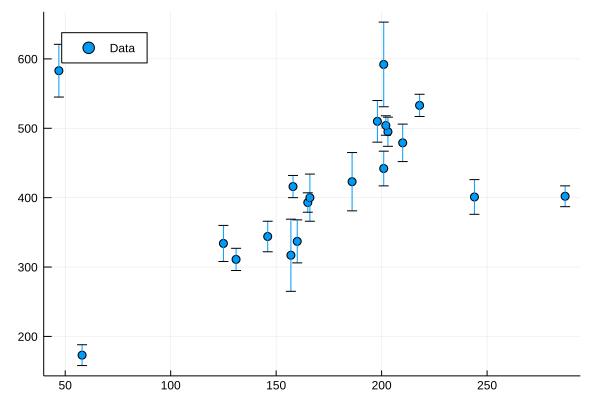

In [4]:
plot(x, y, yerr=yerr, seriestype=:scatter, legend=:topleft, label="Data")

Let's write down our foreground-background model log-likelihood function.  (I grabbed it from lab2-completed!)

In [5]:
function fgbg_line_log_likelihood(x, y, sigma, b, m, pbad, Y, V)
    # If the "pbad" parameter goes outside the range 0 to 1, the prior is zero, so bail out.
    if (pbad < 0) || (pbad > 1)
        return -Inf
    end
    # If the "V" parameter goes negative, the prior is zero; bail out.
    if (V < 0)
        return -Inf
    end
    # Note -- don't work in log space here, and do include the 1/(sqrt(2*pi)*sigma) term.
    p_fg = @. 1. / (sqrt(2. *pi) * sigma) * exp(-0.5 * (b + m*x - y)^2/(sigma^2))
    bg_var = @. sigma^2 + V
    p_bg = @. 1. / sqrt(2. *pi*bg_var) * exp(-0.5 * (y - Y)^2/bg_var)
    # Here, we weight the foreground probability by 1-pbad and the background by pbad,
    # and then take the log.
    lnl = sum(log.(
            (1. .- pbad).*p_fg .+
            pbad.*p_bg))
    return lnl
end;

And define a shortcut version with our data wired in.  We're going to treat this as a log-posterior function -- with implied flat (improper) priors on $b$, $m$, and $Y$.

In [6]:
function fgbg_logprob(params)
    # "unpack" the parameteres
    b, m, pbad, Y, V = params
    fgbg_line_log_likelihood(x, y, yerr, b, m, pbad, Y, V)
end;

Now, one thing we can do to better understand this parameter space is to hold the $pbad$, $Y$, and $V$ parameters fixed, and map out the probability space in $b$ and $m$ by computing the probabilities on a 2-D grid.  (Working in the 5-D grid is difficult!)

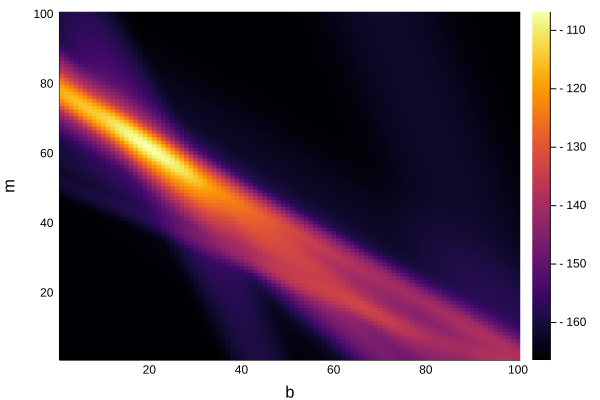

In [7]:
Y = mean(y)
V = var(y)
pbad = 0.1

blo,bhi = -100., 600.
mlo,mhi = -0.5, 4.
bb = range(blo, stop=bhi, length=100)
mm = range(mlo, stop=mhi, length=100)
LL = zeros((length(mm), length(bb)))
for i in 1:length(mm)
    for j in 1:length(bb)
        LL[i, j] = fgbg_logprob((bb[j], mm[i], pbad, Y, V))
    end
end
heatmap(LL, xlabel="b", ylabel="m")

From this, you can see that our probability space is actually pretty complicated, with multiple branches (corresponding to different subsets of the data being fit by the "foreground" model).

(Note that this was log-likelihood; when you take the exp() to get to the straight-up likelihood, the space does not look so complicated!)

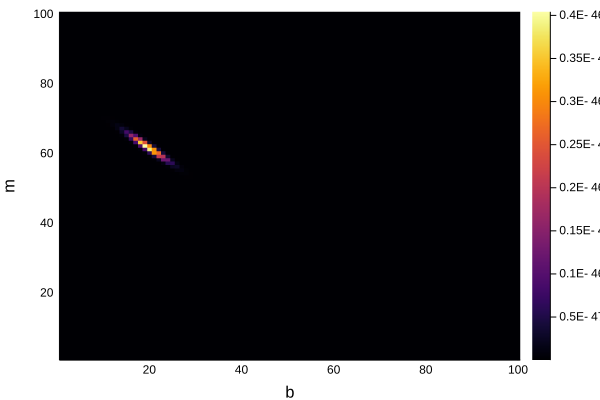

In [8]:
heatmap(exp.(LL), xlabel="b", ylabel="m")

Here's a Metropolis-Hastings MCMC function:

In [9]:
function run_mcmc(logprob_function, initial, jumpsizes, nsteps)
    nparams = length(initial)
    chain = zeros((nsteps, nparams))
    logprobs = zeros(nsteps)
    params = initial
    logprob = logprob_function(params)
    accepts = 0
    for i in 1:nsteps
        params_new = params .+ randn(nparams) .* jumpsizes
        logprob_new = logprob_function(params_new)
        if (exp(logprob_new - logprob) >= rand(Float64))
            logprob = logprob_new
            params = params_new
            accepts += 1
        end
        chain[i,:] .= params
        logprobs[i] = logprob
    end
    return chain, logprobs, accepts / nsteps
end;

Let's run it with our foreground-background probability space for 1,000 steps and see what we get.

In [10]:
initial = [50., 2., 0.1, mean(y), var(y)]
jumpsizes = [10., 0.1, 0.01, 10., 100.]
chain,logprobs,acceptance = run_mcmc(fgbg_logprob, initial, jumpsizes, 1_000);
acceptance

0.345

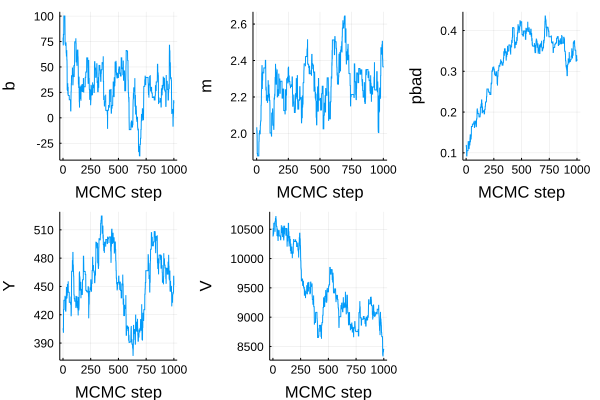

In [11]:
names = ["b", "m", "pbad", "Y", "V"]
plots = []
for (i,n) in enumerate(names)
    p = plot(chain[:,i], xlabel="MCMC step", ylabel=n, label="") #"Param value", label=n)
    push!(plots, p)
end
plot(plots...)

That actually looks pretty good -- it hasn't quite settled down into a stable pattern yet, but it looks like our jump sizes are not too bad.  But the acceptance rate is a little low.  I wonder which jump size we should change?

With our current algorithm, there's not much we can do to figure out which parameter's jump size we should change; we're jumping in all parameters at once.  But we can write a variant (a simple form of "Gibbs sampling") where we choose one of the parameters at random at each step, and jump in only that parameter.  We can then record acceptance ratios for each parameter separately.

In [12]:
function run_gibbs_mcmc(logprob_function, initial, jumpsizes, nsteps)
    nparams = length(initial)
    chain = zeros((nsteps, nparams))
    logprobs = zeros(nsteps)
    params = initial
    logprob = logprob_function(params)
    accepts = zeros(nparams)
    tries = zeros(nparams)
    for i in 1:nsteps
        # Choose which parameter to adjust this time
        j = rand(1:nparams)
        # Jump just that parameter.
        params_new = copy(params)
        params_new[j] += randn() * jumpsizes[j]
        logprob_new = logprob_function(params_new)
        if (exp(logprob_new - logprob) >= rand(Float64))
            logprob = logprob_new
            params = params_new
            accepts[j] += 1
        end
        tries[j] += 1
        chain[i,:] .= params
        logprobs[i] = logprob
    end
    return chain, logprobs, accepts ./ tries
end;

In [13]:
initial = [50., 2., 0.1, mean(y), var(y)]
jumpsizes = [10., 0.1, 0.01, 10., 100.]
chain,logprobs,acceptance = run_gibbs_mcmc(fgbg_logprob, initial, jumpsizes, 1_000);
acceptance

5-element Array{Float64,1}:
 0.4729064039408867 
 0.41397849462365593
 0.9526315789473684 
 0.9757281553398058 
 0.9953488372093023 

Aha, so look, the acceptance rates for my "Y" and "V" parameters are nearly 1, so we can crank those ones up.

It is worth noting, also, that the acceptance rates can be quite different in different parts of the parameter space, depending on how narrow and steep the "ridge" of high probability is.

In [14]:
initial = [50., 2., 0.1, mean(y), var(y)]
jumpsizes = [5., 0.03, 0.1, 50., 5000]
chain,logprobs,acceptance = run_gibbs_mcmc(fgbg_logprob, initial, jumpsizes, 10_000);
acceptance

5-element Array{Float64,1}:
 0.7394153225806451
 0.7213284898806435
 0.6993076162215628
 0.8415741675075681
 0.9170263788968825

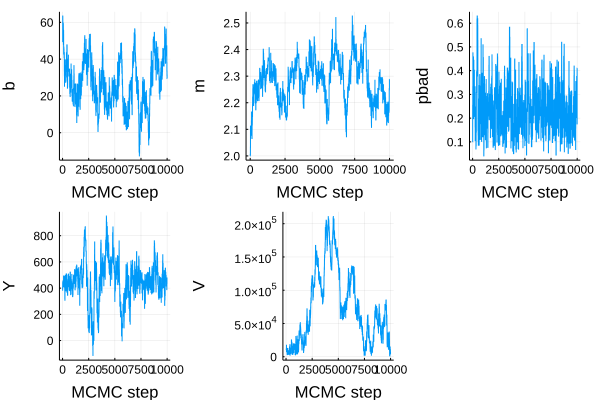

In [15]:
names = ["b", "m", "pbad", "Y", "V"]
plots = []
for (i,n) in enumerate(names)
    p = plot(chain[:,i], xlabel="MCMC step", ylabel=n, label="")
    push!(plots, p)
end
plot(plots...)

In [16]:
initial = [50., 2., 0.1, mean(y), var(y)]
jumpsizes = [5., 0.03, 0.1, 50., 5000]
chain,logprobs,acceptance = run_mcmc(fgbg_logprob, initial, jumpsizes, 10_000);
acceptance

0.4344

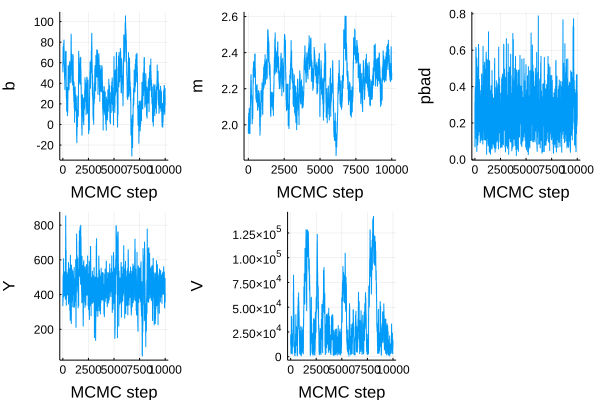

In [17]:
names = ["b", "m", "pbad", "Y", "V"]
plots = []
for (i,n) in enumerate(names)
    p = plot(chain[:,i], xlabel="MCMC step", ylabel=n, label="")
    push!(plots, p)
end
plot(plots...)

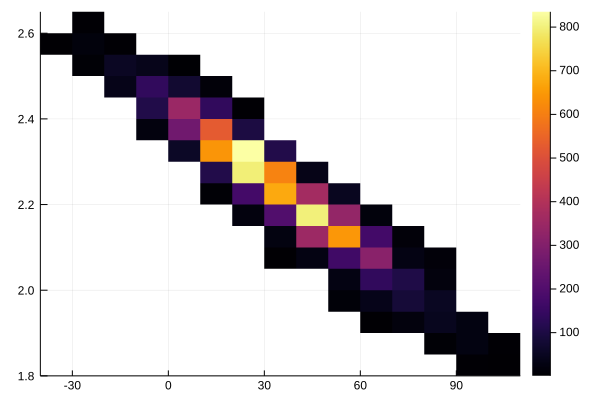

In [18]:
histogram2d(chain[:,1], chain[:,2])

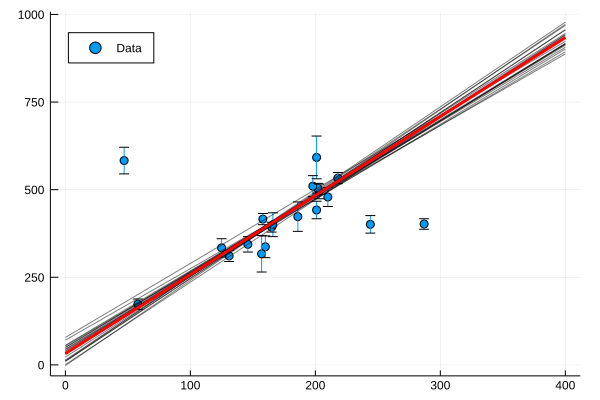

In [19]:
samples = chain[rand(1000:(size(chain)[1]), 20), :]
plot(x, y, yerr=yerr, seriestype=:scatter, legend=:topleft, label="Data")
for i in 1:size(samples)[1]
    b = samples[i, 1]
    m = samples[i, 2]
    plot!([0,400], x->b+m*x, alpha=0.5, color=:black, label="")
end
meanb,meanm = mean(chain[1000:end, 1]), mean(chain[1000:end, 2])
plot!([0,400], x->meanb+meanm*x, color=:red, label="", linewidth=3)

Let's take a *few* more samples and plot the $b$,$m$ histogram:

In [20]:
chain,logprobs,acceptance = run_mcmc(fgbg_logprob, initial, jumpsizes, 1_000_000);
acceptance

0.43116

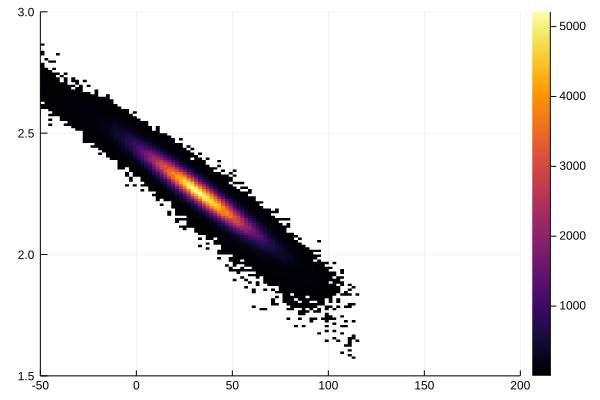

In [21]:
histogram2d(chain[:,1], chain[:,2], xlim=(-50,200), ylim=(1.5, 3.0))

Let's try making one of those "corner" plots like you see in the literature:

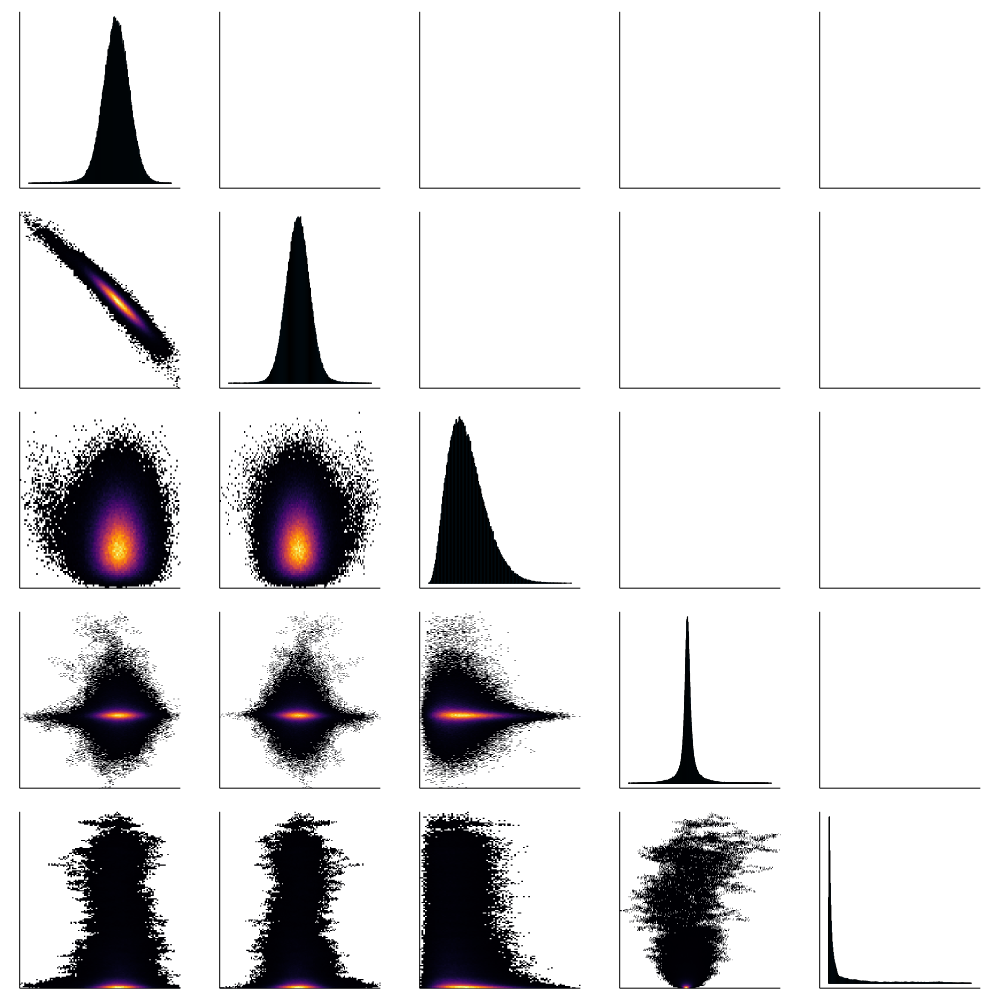

In [22]:
# Take a subset of the chain -- drop the burn-in samples
csub = chain[10000:end, :]
# How many dimensions do we have?
N = 5
# Hack -- put in the plot limits by hand.
limits = [ [-50,100], [1.75,2.75], [0,1], [-200,1200], [0,5e5]]
# Plot layout is a grid
l = @layout( grid(N,N) )
# We're going to populate this "hists" list with a grid of plots, top to bottom.
hists = []
for i in 1:N
    # The plots to the left of the diagonal are the 2-D projections (i vs j)
    for j in 1:i-1
        h = histogram2d(csub[:,j], csub[:,i], colorbar=false, ticks=nothing,
                xlim=limits[j,:], ylim=limits[i,:]) #, palette=:blues)
        push!(hists, h)
    end
    # The plots on the diagonal are the 1-D projections
    h = histogram(csub[:,i], legend=false, ticks=nothing, xlim=limits[i,:])
    push!(hists,h)
    # To the right of the diagonal is empty.  I couldn't figure out how to get really empty plots.
    for j in i+1:N
        e = plot([], leg=false, ticks=nothing, border=false) #, foreground_color_axis=nothing) #, grid=false)
        push!(hists, e)
    end
end
plot(hists..., layout=l, size=(1000,1000), palette=:blues)

This still leaves a lot to be desired (we should label the axes, but only on the bottom/left edges; the color scheme is not great; contours on the data points would be better; etc), but you can at least see what the covariances look like.

Just for kicks, here is one hacky way I found of plotting contours around the samples, by first computing a 2d histogram:

┌ Warning: Default for keyword argument "closed" has changed from :right to :left.
│ To avoid this warning, specify closed=:right or closed=:left as appropriate.
│   caller = #fit#106 at hist.jl:340 [inlined]
└ @ Core /Users/dstn/.julia/packages/StatsBase/NzjNi/src/hist.jl:340


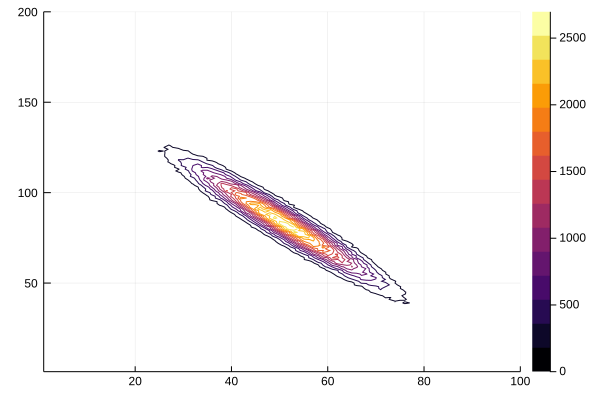

In [23]:
# (No need to install this package and run this cell if you don't want to bother)
using StatsBase
hist = fit(Histogram, (csub[:,1], csub[:,2]), (-50.:1.:150., 1.75:0.01:2.75))
contour(hist.weights)

# The *emcee* ensemble sampler

We have looked at using Gibbs sampling one parameter at a time as a tool for tuning the jump sizes in the Metropolis-Hastings MCMC algorithm.  This helped us to find jump sizes that gave reasonable acceptance ratios, but it still doesn't help with the fact that our $b$ and $m$ parameters are quite degenerate.  We could try to jump along that covariance ellipse rather than along the axis-aligned ellipse as we implemented.

Instead, we're now going to look at a different sampling algorithm: an ensemble sampler using the "Stretch Move" proposed by Goodman & Weare (2010).  This has the huge advantage that we don't have to specify jump sizes -- the sampler "learns" the local shape of the distribution and uses that to propose jumps.

The *emcee* implementation of this algorithm (Foreman-Mackey et al., 2013), in python, has become hugely popular in astrophysics (2000 citations; growing each year).

In [24]:
function ensemble_sampler(logprob_func, initial, nsteps)
    # A translation of the "emcee" ensemble sampler by Dan Foreman-Mackey,
    # http://arxiv.org/abs/1202.3665.  This is "Algorithm 3" in that paper.
    #
    # *logprob_func* is a log-posterior-probability function of the parameters.
    # *initial* must be an array with shape (Nwalkers, Nparams)
    # *nsteps* is the desired number of MCMC steps to take
    #
    nwalkers, nparams = size(initial)
    if (nwalkers % 2 != 0)
        println("NWalkers must be even")
        return
    end
    chain = zeros((nsteps, nwalkers, nparams))
    logprobs = zeros(nwalkers)
    nhalf = Int(nwalkers/2)
    # Start at initial parameter values
    params = initial
    for j in 1:nwalkers
        logprobs[j] = logprob_func(params[j,:])
    end
    # "Stretch move" parameter
    alpha = 2.
    # Tried moves
    tries = 0
    # Accepted moves
    accepts = 0
    for i in 1:nsteps
        # At each step, we first update one half of the ensemble (holding the other half fixed)
        # and then updated the second half (holding the first half, with its updated values, fixed)
        for half in 0:1
            for j in 1:nhalf
                # We're going to update the walker at index "me":
                me = half*nhalf + j
                # Draw a walker from the other half of the walkers
                other = (1-half)*nhalf + rand(1:nhalf)
                # Draw the "stretch move" distance
                z = ((alpha - 1.) * rand(Float64) + 1)^2 / alpha
                # Compute the parameter value -- it is along the line connecting "me" and "other"
                params_new = params[other,:] .+ z .* (params[me,:] - params[other,:])
                # Compute the log-prob at the new sample location
                logprob_new = logprob_func(params_new)
                # There is an extra term that weights the proposal distribution -- required to maintain
                # detailed balance.
                logproposal = (nparams-1) * log(z)
                tries += 1
                # Keep this new sample?
                if exp(logproposal + logprob_new - logprobs[me]) >= rand(Float64)
                    # Keep it!
                    params[me,:] = params_new
                    logprobs[me] = logprob_new
                    accepts += 1
                end
                # Record the chosen parameter values
                chain[i, me, :] .= params[me, :]
            end
        end
    end
    return chain, accepts/tries
end;

In [25]:
# Let's use the same initialization as before
initial = [50., 2., 0.1, mean(y), var(y)]
# But NOW, we don't need to hand-tune the jump sizes -- choosing tiny values usually works well.
# The sampler will expand the ball of walkers out from the initial sample point.
jumpsizes = ones(length(initial)) * 1e-6
nparams = length(initial)
# Normally you want to make the number of walkers significantly larger than the number of parameters.
# (50 might be a good number for our 5-parameter model)  But for ease of plotting, we'll go smaller.
nwalkers = 20

# We're going to initialize the walkers in a ball around the *initial* location.
walkers = zeros((nwalkers, nparams))
for i in 1:nwalkers
    walkers[i,:] = initial + randn(nparams) .* jumpsizes
end
# Call the sampler!
nsteps = 10_000
chain,acceptance = ensemble_sampler(fgbg_logprob, walkers, nsteps)
acceptance

0.40528

In [26]:
size(chain)

(10000, 20, 5)

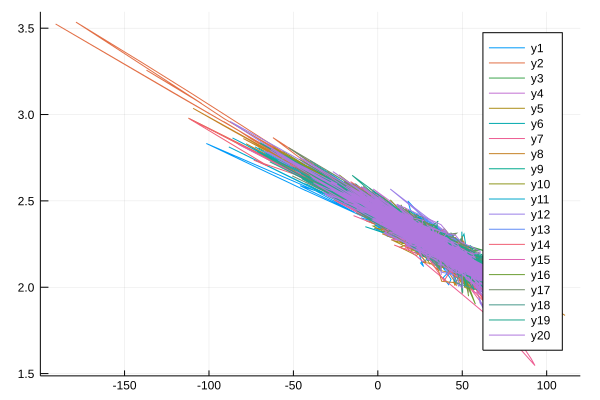

In [27]:
plot(chain[:,:,1], chain[:,:,2])
#plot(chain[100:end,:,1], chain[100:end,:,2])

Let's look at what the sampler did initially -- remember that we initialized it from a tiny ball in parameter space.

Try advancing different step numbers to see how the ensemble of "walkers" move through the space.

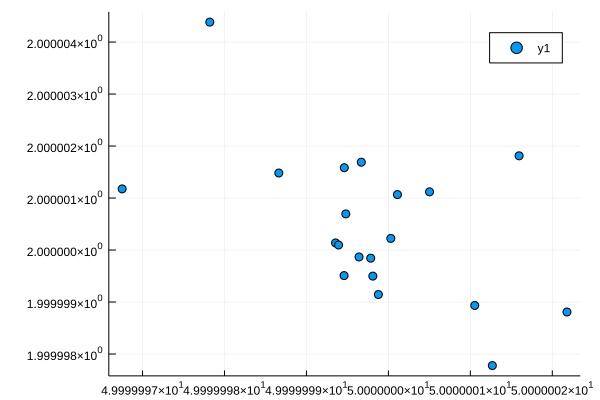

In [28]:
stepnum = 1
plot(chain[stepnum,:,1], chain[stepnum,:,2], seriestype=:scatter)

At the end of the chain, the walkers are sitting around the peak, nicely sampling along their covariance direction.

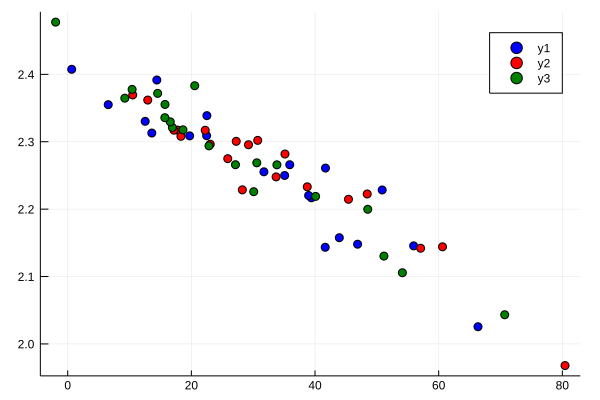

In [29]:
plot(chain[end,:,1], chain[end,:,2], seriestype=:scatter, color=:blue)
plot!(chain[end-100,:,1], chain[end-100,:,2], seriestype=:scatter, color=:red)
plot!(chain[end-200,:,1], chain[end-200,:,2], seriestype=:scatter, color=:green)

In [30]:
# You could try plotting ellipses showing the mean and variance of the ensemble of walkers --
# this is the sampler's estimate of the covariance of the distribution.
for stepnum in 1:100:1000
    bb = chain[stepnum, :, 1]
    mm = chain[stepnum, :, 2]
    meanb = mean(bb)
    meanm = mean(mm)
    C = Matrix{Float64}(undef, 2,2)
    C[1,1] = var(bb)
    C[2,2] = var(mm)
    C[1,2] = C[2,1] = cov(bb, mm)
    #println(C)
    println(sqrt(C))
    # PLOT an ellipse...
end

[1.16829e-6 -3.67861e-7; -3.67861e-7 1.38911e-6]
[1.29418 -0.036746; -0.036746 0.0463456]
[19.4308 -0.0963992; -0.0963992 0.051219]
[18.3199 -0.0956542; -0.0956542 0.0435449]
[19.6493 -0.122697; -0.122697 0.0361308]
[14.0381 -0.0898378; -0.0898378 0.0285576]
[20.5018 -0.116344; -0.116344 0.0238012]
[17.49 -0.111649; -0.111649 0.0298656]
[21.4076 -0.10389; -0.10389 0.0334194]
[19.5323 -0.104111; -0.104111 0.0354898]


In [31]:
p1 = plot(chain[:,:,1], legend=false, ylabel="b", xlabel="MCMC step")
p2 = plot(chain[:,:,2], legend=false, ylabel="m", xlabel="MCMC step")
p3 = plot(chain[:,:,3], legend=false, ylabel="Pbad", xlabel="MCMC step")
p4 = plot(chain[:,:,4], legend=false, ylabel="Y", xlabel="MCMC step")
#p5 = plot(log10.(chain[:,:,5]), legend=false, ylabel="log(V)", xlabel="MCMC step")
p5 = plot(chain[:,:,5], legend=false, ylabel="V", xlabel="MCMC step")
plot(p1,p2,p3,p4,p5)

Wow, the $Y$ and $V$ parameters went weird there!  If you want, you can try to investigate what happened.  (Hint: in the foreground-background model, we work in probability, not log-probabilty space.)  Can you alter the algorithm to avoid this problem?  (Hint: the "logsumexp" function exists for problems like this.)

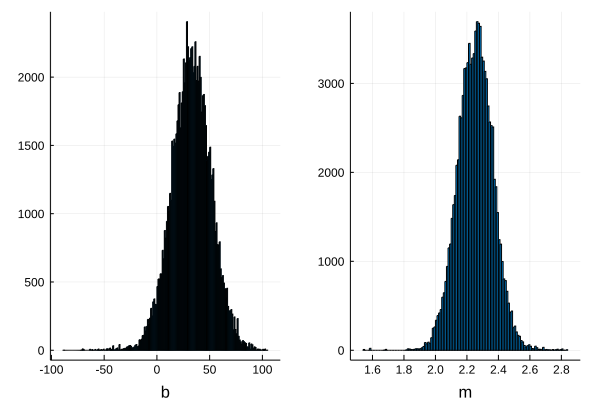

In [32]:
burnin = 5_000
flat = chain[burnin:end,:,:]
nb,nw,np = size(flat)
flat = reshape(flat, (nb*nw,np));
h1 = histogram(flat[:,1], xlabel="b", label="")
h2 = histogram(flat[:,2], xlabel="m", label="")
plot(h1,h2)

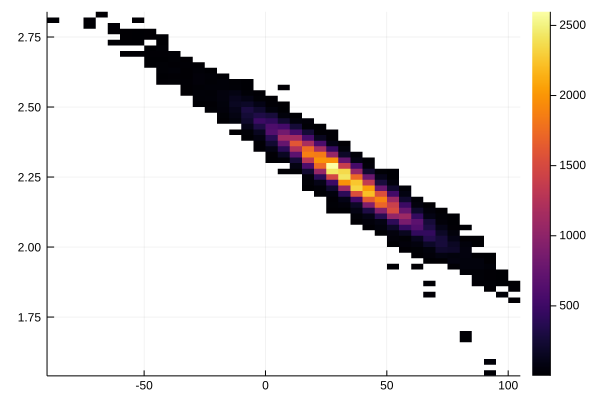

In [33]:
histogram2d(flat[:,1], flat[:,2])

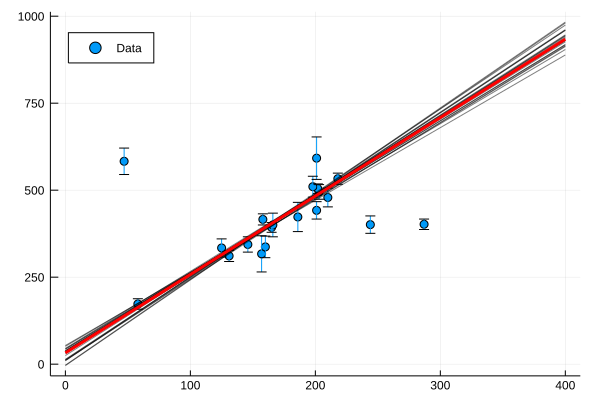

In [34]:
nsteps,npar = size(flat)
samples = flat[rand(1:nsteps, 20), :]
plot(x, y, yerr=yerr, seriestype=:scatter, legend=:topleft, label="Data")
for i in 1:size(samples)[1]
    b = samples[i, 1]
    m = samples[i, 2]
    plot!([0,400], x->b+m*x, alpha=0.5, color=:black, label="")
end
meanb,meanm = mean(flat[:,1]), mean(flat[:,2])
plot!([0,400], x->meanb+meanm*x, color=:red, label="", linewidth=3)
#plot!()